## 0. Load sample

In [1]:
import openslide
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import cv2
import os
import random
import shutil
import scipy.misc
import scipy.ndimage
from skimage import io
from skimage import morphology
from skimage import measure

from lxml import etree
import math
import glob
from PIL import Image, ImageFilter
import imutils
import tifffile as tiff

# copy & paste directory into path_common 
path_common = '../'

In [2]:
fname_WSI = 'S 050026746_8_PAS.svs'
path_WSI = os.path.join(path_common, 'data/', fname_WSI)
path_out_tissue_mask = os.path.join(path_common , 'mask/')
if not os.path.exists(path_out_tissue_mask):
    os.makedirs(path_out_tissue_mask)

In [3]:
fname_XML = 'S 050026746_8_PAS.xml'
path_XML = os.path.join(path_common, 'data/', 'S 050026746_8_PAS.xml')

In [4]:
def make_mask(path_WSI, path_XML, id_list):
    tree = etree.parse(path_XML)
    root = tree.getroot()

    cnt = []

    for root_ in (root.iter('Annotation')):
    # class level
    #     print(root_.attrib)        
        if root_.attrib['Id'] in id_list:
            for anno_ in (root_.iter('Region')):
                # single tissue level
                rect_ = []

                for child in anno_.iter("Vertex"):
                    # contour points level
                    cooldinates = child.attrib

                    x_ = int(round(float(cooldinates.get('X')))) // 4
                    y_ = int(round(float(cooldinates.get('Y')))) // 4
                    rect_.append((x_, y_))

                cnt.append(rect_)

    image = openslide.OpenSlide(path_WSI)
    w,h = image.level_dimensions[1]

    mask = np.zeros((h,w),dtype=np.uint8)

    for i in range(len(cnt)):
        mask_pts = np.array(cnt[i]).reshape((-1, 1, 2)).astype(np.int32)
        cv2.fillPoly(mask, [mask_pts], [255])
    
    return mask, cnt

In [5]:
id_list = ['1', '2', '3', '4', '5', '6']
main, cnt = make_mask(path_WSI, path_XML, id_list)
print('Num of masks: ', len(cnt))

Num of masks:  8


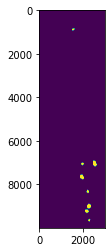

In [6]:
main_seg = main[:10000, 19000:22000]
plt.imshow(main_seg)
plt.show()

## 1. Show layers

In [7]:
masks = []
for i in id_list:
    mask, cnt = make_mask(path_WSI, path_XML, i)
    print(f'Num of masks{i}: ', len(cnt))
    masks.append(mask)

Num of masks1:  4
Num of masks2:  2
Num of masks3:  0
Num of masks4:  2
Num of masks5:  0
Num of masks6:  0


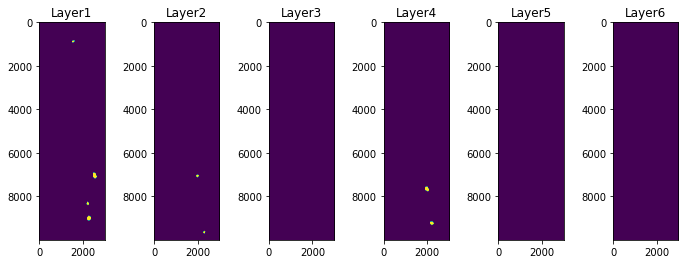

In [8]:
plt.figure(figsize=(12, 4))

for i in range(6):
    plt.subplot(161+i)
    plt.title(f'Layer{1+i}')
    plt.imshow(masks[i][:10000, 19000:22000])
    
plt.show()

## 2. Blend all images

In [9]:
im_pred = tiff.imread(os.path.join(path_common, 'results/', f"{fname_WSI[:-4]}_pred.tiff"))
im_WSI = tiff.imread(os.path.join(path_common, 'data/', f"{fname_WSI[:-4]}.tiff"))
im_mask = tiff.imread(os.path.join(path_common, 'mask/', f"{fname_WSI[:-4]}_mask.tiff"))

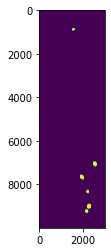

In [10]:
plt.imshow(im_pred)
plt.show()

In [11]:
RGBforLabel = {1:(0,0,255), 
               2:(0,255,0), 
               3:(255,0,0),
               4:(255,0,255),
               5:(0,255,255), 
               6:(255,255,0)}

# Blue - Layer 1: No lesion  
# Green - Layer 2: GS (global sclerosis)  
# Red - Layer 3: SS (Segmental sclerosis)  
# Purple -  4: Cr (Crescent)  
# Sky - Layer 5: Ischemic collapse  
# Yellow - Layer 6: Other lesions  

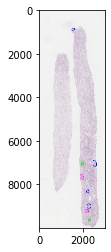

In [12]:
for i in id_list:
    mask, cnt = make_mask(path_WSI, path_XML, i)
    seg = mask[:10000, 19000:22000]
    contours, _ = cv2.findContours(seg,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
    for c in contours:
        label = int(i)
        colour = RGBforLabel.get(label)
        cv2.drawContours(im_WSI,[c],-1,colour,20)

plt.imshow(im_WSI)
plt.show()

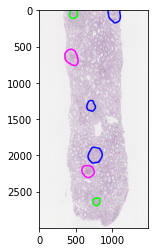

In [13]:
plt.imshow(im_WSI[7000:, 1500:])
plt.show()

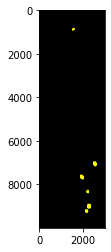

In [14]:
dim = np.zeros((im_pred.shape[0], im_pred.shape[1]))
pred_mask = np.stack((im_pred, im_pred, dim), axis=2)
pred_mask = np.uint8(pred_mask)*255
plt.imshow(pred_mask)
plt.show()

In [15]:
alpha = 0.3
blended = cv2.addWeighted(pred_mask, alpha, im_WSI, 1-alpha, 0)

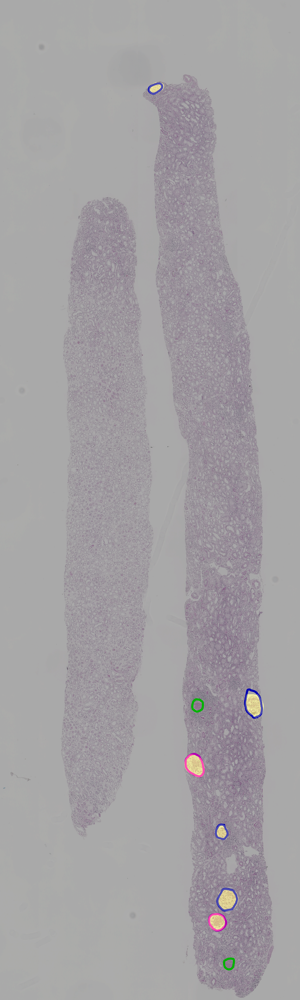

In [16]:
Image.fromarray(blended)

In [17]:
Image.fromarray(blended).save("./results/S 050026746_8_PAS_blended.tiff")

In [25]:
mask_rgb = np.stack((im_mask, im_mask, im_mask), axis=2)

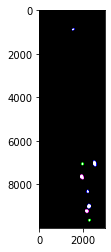

In [26]:
for i in id_list:
    mask, cnt = make_mask(path_WSI, path_XML, i)
    seg = mask[:10000, 19000:22000]
    contours, _ = cv2.findContours(seg,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
    for c in contours:
        label = int(i)
        colour = RGBforLabel.get(label)
        cv2.drawContours(mask_rgb,[c],-1,colour,20)

plt.imshow(mask_rgb)
plt.show()

In [28]:
Image.fromarray(mask_rgb).save("./mask/S 050026746_8_PAS_mask_layers.tiff")